**Nguyễn Ngọc Hà My**

email: hamy95637@gmail.com

In [1]:
!pip install tsfresh==0.20.2 scipy==1.13.1

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.8/95.8 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.5/176.5 kB 6.2 MB/s eta 0:00:00


In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

#plotting
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

# Time Series - EDA and Modelling
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA

# FE
from tsfresh import extract_features, select_features, extract_relevant_features
from tsfresh.utilities.dataframe_functions import impute
from sklearn.inspection import permutation_importance

# Metrics
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error

# Modeling and preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR, LinearSVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import BaggingRegressor, AdaBoostRegressor
from sklearn.neural_network import MLPRegressor
from prophet import Prophet
import xgboost as xgb
from xgboost import XGBRegressor
import lightgbm as lgb
from lightgbm import LGBMRegressor

import warnings
warnings.filterwarnings("ignore")

/usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Data Analysis

## Load data & Pre-processing

In [4]:
fpt = pd.read_csv('/content/drive/MyDrive/crypto/FPT.csv')
msn = pd.read_csv('/content/drive/MyDrive/crypto/MSN.csv')
pnj = pd.read_csv('/content/drive/MyDrive/crypto/PNJ.csv')
vic = pd.read_csv('/content/drive/MyDrive/crypto/VIC.csv')

In [ ]:
pnj

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
0,PNJ,2/28/2018 9:15,78.14,78.99,78.14,78.99,270,0
1,PNJ,2/28/2018 9:16,78.94,78.94,78.94,78.94,10,0
2,PNJ,2/28/2018 9:19,78.14,78.14,78.14,78.14,283,0
3,PNJ,2/28/2018 9:20,78.14,78.14,78.14,78.14,480,0
4,PNJ,2/28/2018 9:21,78.14,78.14,78.14,78.14,146,0
...,...,...,...,...,...,...,...,...
125304,PNJ,12/22/2020 14:22,78.20,78.20,78.20,78.20,5000,0
125305,PNJ,12/22/2020 14:23,78.20,78.20,78.20,78.20,1700,0
125306,PNJ,12/22/2020 14:24,78.20,78.20,78.20,78.20,870,0
125307,PNJ,12/22/2020 14:25,78.10,78.10,78.10,78.10,13000,0


all separated csv files contain ```Ticker``` feature to catergorize crypto's type. So we can merge all 4 csv files without preprocessing anything else.

So I will analysis on ```data```

In [ ]:
data = pd.concat([fpt, msn, pnj, vic], ignore_index=True)
data

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
0,FPT,12/25/2018 9:15,30.89,30.89,30.89,30.89,35410,0
1,FPT,12/25/2018 9:16,30.81,30.81,30.81,30.81,190,0
2,FPT,12/25/2018 9:17,30.74,30.81,30.74,30.74,1120,0
3,FPT,12/25/2018 9:18,30.74,30.74,30.74,30.74,2120,0
4,FPT,12/25/2018 9:19,30.74,30.74,30.74,30.74,22500,0
...,...,...,...,...,...,...,...,...
459330,VIC,12/22/2020 14:22,105.80,105.80,105.70,105.70,1870,0
459331,VIC,12/22/2020 14:23,105.70,105.70,105.70,105.70,2510,0
459332,VIC,12/22/2020 14:24,105.70,105.70,105.70,105.70,3620,0
459333,VIC,12/22/2020 14:25,105.70,105.70,105.70,105.70,100,0


In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Open,459335.0,74.545826,23.023346,30.25,54.19,75.73,90.1,126.1
High,459335.0,74.626579,23.038201,30.25,54.25,75.92,90.2,126.5
Low,459335.0,74.481065,23.011619,30.22,54.15,75.60,90.0,126.1
Close,459335.0,74.546183,23.024380,30.25,54.19,75.72,90.1,126.5
Volume,459335.0,4909.389622,19021.044103,1.00,360.00,1500.00,4920.0,3300680.0
Open Interest,459335.0,0.000000,0.000000,0.00,0.00,0.00,0.0,0.0


the feature ```Open Interest``` doesn't have any useful because it have only 1 value ```0``` for all sample so I will exclude it

In [ ]:
# check the value of Open Interest
data['Open Interest'].value_counts()

,count
Open Interest,
0,459335


In [ ]:
# Exclude Open Interest feature
data = data.drop(columns=['Open Interest'])
data

,Ticker,Date/Time,Open,High,Low,Close,Volume
0,FPT,12/25/2018 9:15,30.89,30.89,30.89,30.89,35410
1,FPT,12/25/2018 9:16,30.81,30.81,30.81,30.81,190
2,FPT,12/25/2018 9:17,30.74,30.81,30.74,30.74,1120
3,FPT,12/25/2018 9:18,30.74,30.74,30.74,30.74,2120
4,FPT,12/25/2018 9:19,30.74,30.74,30.74,30.74,22500
...,...,...,...,...,...,...,...
459330,VIC,12/22/2020 14:22,105.80,105.80,105.70,105.70,1870
459331,VIC,12/22/2020 14:23,105.70,105.70,105.70,105.70,2510
459332,VIC,12/22/2020 14:24,105.70,105.70,105.70,105.70,3620
459333,VIC,12/22/2020 14:25,105.70,105.70,105.70,105.70,100


In [ ]:
# checking data type
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 459335 entries, 0 to 459334
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Ticker     459335 non-null  object 
 1   Date/Time  459335 non-null  object 
 2   Open       459335 non-null  float64
 3   High       459335 non-null  float64
 4   Low        459335 non-null  float64
 5   Close      459335 non-null  float64
 6   Volume     459335 non-null  int64  
dtypes: float64(4), int64(1), object(2)
memory usage: 24.5+ MB


```Date/Time```should be in datetime dtype but it's object dtype so we need to change it into right dtype

In [ ]:
data['Date/Time'] = pd.to_datetime(data['Date/Time'],format='%m/%d/%Y %H:%M')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 459335 entries, 0 to 459334
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Ticker     459335 non-null  object        
 1   Date/Time  459335 non-null  datetime64[ns]
 2   Open       459335 non-null  float64       
 3   High       459335 non-null  float64       
 4   Low        459335 non-null  float64       
 5   Close      459335 non-null  float64       
 6   Volume     459335 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 24.5+ MB


In [ ]:
data.set_index('Date/Time', inplace=True)
data

,Ticker,Open,High,Low,Close,Volume
Date/Time,,,,,,
2018-12-25 09:15:00,FPT,30.89,30.89,30.89,30.89,35410
2018-12-25 09:16:00,FPT,30.81,30.81,30.81,30.81,190
2018-12-25 09:17:00,FPT,30.74,30.81,30.74,30.74,1120
2018-12-25 09:18:00,FPT,30.74,30.74,30.74,30.74,2120
2018-12-25 09:19:00,FPT,30.74,30.74,30.74,30.74,22500
...,...,...,...,...,...,...
2020-12-22 14:22:00,VIC,105.80,105.80,105.70,105.70,1870
2020-12-22 14:23:00,VIC,105.70,105.70,105.70,105.70,2510
2020-12-22 14:24:00,VIC,105.70,105.70,105.70,105.70,3620


## EDA

I need to consider if there is any differences between FPT, MSN, VIC, PNJ crypto before building predictive models. I'll do some statistical assessments.

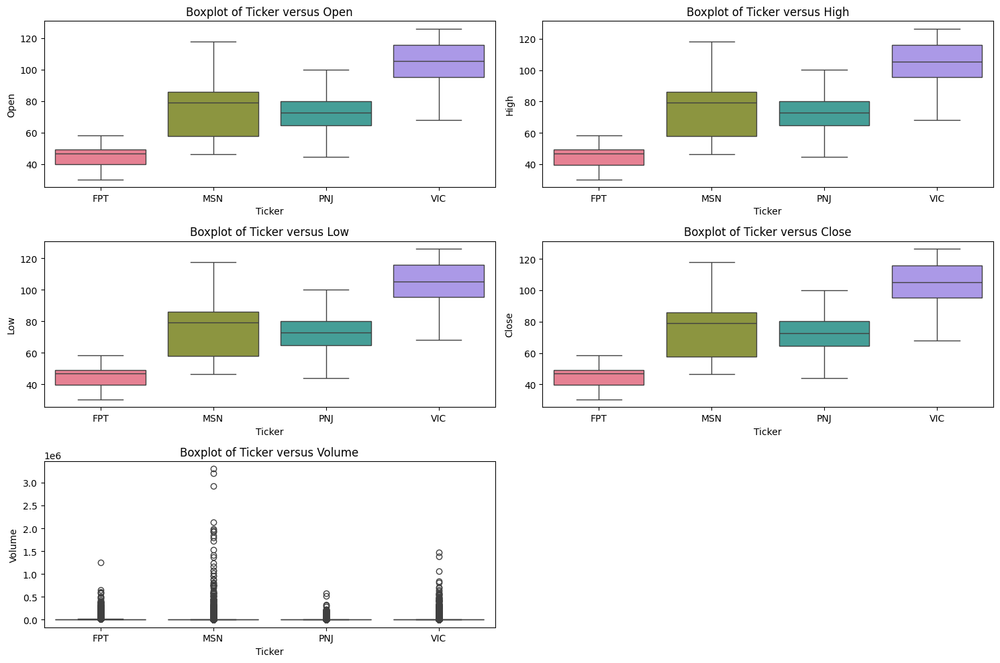

In [ ]:
plt.figure(figsize=(15, 10))
features = ['Open', 'High', 'Low', 'Close', 'Volume']

# Define a unique color palette for Tickers
unique_tickers = data['Ticker'].unique()
palette = sns.color_palette("husl", len(unique_tickers))  # Use a color palette with unique colors

for i in range(len(features)):
    plt.subplot(3, 2, i + 1)
    sns.boxplot(data=data, x="Ticker", y=features[i], hue="Ticker", dodge=False,
                palette=dict(zip(unique_tickers, palette)), legend=False)
    plt.title(f'Boxplot of Ticker versus {features[i]}')

plt.tight_layout()  # To prevent overlap of subplots
plt.show()


### Display Candlestrick chart

In [ ]:
# FPT Candlestick
fig = go.Figure(data=[go.Candlestick(x=data[data['Ticker'] == 'FPT'].index,
                open=data[data['Ticker'] == 'FPT']['Open'], high=data[data['Ticker'] == 'FPT']['High'],
                low=data[data['Ticker'] == 'FPT']['Low'], close=data[data['Ticker'] == 'FPT']['Close'])
                     ])
%matplotlib inline
fig.show()

In [ ]:
# PNJ Candlestick
fig = go.Figure(data=[go.Candlestick(x=data[data['Ticker'] == 'PNJ'].index,
                open=data[data['Ticker'] == 'PNJ']['Open'], high=data[data['Ticker'] == 'PNJ']['High'],
                low=data[data['Ticker'] == 'PNJ']['Low'], close=data[data['Ticker'] == 'PNJ']['Close'])
                     ])
%matplotlib inline
fig.show()

In [ ]:
# MSN Candlestick
fig = go.Figure(data=[go.Candlestick(x=data[data['Ticker'] == 'MSN'].index,
                open=data[data['Ticker'] == 'MSN']['Open'], high=data[data['Ticker'] == 'MSN']['High'],
                low=data[data['Ticker'] == 'MSN']['Low'], close=data[data['Ticker'] == 'MSN']['Close'])
                     ])
%matplotlib inline
fig.show()

In [ ]:
# VIC Candlestick
fig = go.Figure(data=[go.Candlestick(x=data[data['Ticker'] == 'VIC'].index,
                open=data[data['Ticker'] == 'VIC']['Open'], high=data[data['Ticker'] == 'VIC']['High'],
                low=data[data['Ticker'] == 'VIC']['Low'], close=data[data['Ticker'] == 'VIC']['Close'])
                     ])
%matplotlib inline
fig.show()

Check if Time Series data is Stationary

In [ ]:
def check_stationarity(series):
    result = adfuller(series.values)

    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

    if (result[1] <= 0.05) & (result[4]['5%'] > result[0]):
        print("\u001b[32mStationary\u001b[0m")
    else:
        print("\x1b[31mNon-stationary\x1b[0m")

In [ ]:
check_stationarity(data['Close'])

Applying data['Date/Time'].diff() to difference the data to remove trends and seasonality, thereby making it stationary. This transformation is crucial for many time series models (like ARIMA) that assume the input data is stationary. By differencing, you eliminate the non-stationary components, making the data more predictable.

In [ ]:
check_stationarity(data['Close'].diff().dropna())

In [ ]:
check_stationarity(data['Close'].diff().diff().dropna())

```Date/Time``` feature is non-stationary .Therefore, it is necessary to model the first difference of the series. I will create feature ```Close_diff``` for this

In [ ]:
data['Close_diff'] = data['Close'].diff()
data = data.dropna()
data

,Ticker,Open,High,Low,Close,Volume,Close_diff
Date/Time,,,,,,,
2018-12-25 09:16:00,FPT,30.81,30.81,30.81,30.81,190,-0.08
2018-12-25 09:17:00,FPT,30.74,30.81,30.74,30.74,1120,-0.07
2018-12-25 09:18:00,FPT,30.74,30.74,30.74,30.74,2120,0.00
2018-12-25 09:19:00,FPT,30.74,30.74,30.74,30.74,22500,0.00
2018-12-25 09:20:00,FPT,30.74,30.74,30.70,30.74,7140,0.00
...,...,...,...,...,...,...,...
2020-12-22 14:22:00,VIC,105.80,105.80,105.70,105.70,1870,-0.10
2020-12-22 14:23:00,VIC,105.70,105.70,105.70,105.70,2510,0.00
2020-12-22 14:24:00,VIC,105.70,105.70,105.70,105.70,3620,0.00


###  Identification of seasonality

VIC

In [ ]:
# Get seasonality of VIC
decomp = seasonal_decompose(data[data['Ticker'] == 'VIC'].Open, period =720)
fig = decomp.plot()
fig.set_size_inches((8, 6))
fig.tight_layout()


In [ ]:
# Get seasonality of recent data of VIC
decomposition = seasonal_decompose(data[data['Ticker'] == 'VIC'].tail(1000).Close, period=30)
fig = decomposition.plot()
fig.set_size_inches((8, 6))
fig.tight_layout()
plt.grid(True)
plt.show()

PNJ

In [ ]:
# Get seasonality of PNJ
decomp = seasonal_decompose(data[data['Ticker'] == 'PNJ'].Open, period =720)
fig = decomp.plot()
fig.set_size_inches((8, 6))
fig.tight_layout()

In [ ]:
# Get seasonality of recent data of PNJ
decomposition = seasonal_decompose(data[data['Ticker'] == 'PNJ'].tail(1000).Close, period=30)
fig = decomposition.plot()
fig.set_size_inches((8, 6))
fig.tight_layout()
plt.grid(True)
plt.show()

MSN

In [ ]:
# Get seasonality of MSN
decomp = seasonal_decompose(data[data['Ticker'] == 'MSN'].Open, period =720)
fig = decomp.plot()
fig.set_size_inches((8, 6))
fig.tight_layout()

In [ ]:
# Get seasonality of recent data of MSN
decomposition = seasonal_decompose(data[data['Ticker'] == 'MSN'].tail(1000).Close, period=30)
fig = decomposition.plot()
fig.set_size_inches((8, 6))
fig.tight_layout()
plt.grid(True)
plt.show()

FPT

In [ ]:
# Get seasonality of FPT
decomp = seasonal_decompose(data[data['Ticker'] == 'FPT'].Open, period =365)
fig = decomp.plot()
fig.set_size_inches((8, 6))
fig.tight_layout()

In [ ]:
# Get seasonality of recent data of FPT
decomposition = seasonal_decompose(data[data['Ticker'] == 'FPT'].tail(1000).Close, period=30)
fig = decomposition.plot()
fig.set_size_inches((8, 6))
fig.tight_layout()
plt.grid(True)
plt.show()

### EDA with Pandas Profiling Report

In [ ]:
!pip install ydata-profiling

In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(data, title="Cryto Profiling Report")
profile.to_notebook_iframe()

# Model

## FE

In [ ]:
def get_tsfresh_features(data):

    data = data.reset_index(drop=False).reset_index(drop=False)

    # Extract features
    extracted_features = extract_features(data, column_id="Date/Time", column_sort="Date/Time")

    # Drop features with NaN
    extracted_features_clean = extracted_features.dropna(axis=1, how='all').reset_index(drop=True)

    # Drop features with constants
    cols_std_zero  = []
    for col in extracted_features_clean.columns:
        if extracted_features_clean[col].std()==0:
            cols_std_zero.append(col)
    extracted_features_clean = extracted_features_clean.drop(columns = cols_std_zero)

    extracted_features_clean['Date/Time'] = data['Date/Time']   # For the merging

    return extracted_features_clean

In [ ]:
import pandas as pd
from tsfresh import extract_features

# Function to process and save features
def process_and_save_features(data, ticker, part, output_dir="/content/drive/MyDrive/crypto/feature_extraction/"):
    # Apply feature extraction
    extracted_features = get_tsfresh_features(data[['Close']])

    # Save to CSV
    file_name = f"{output_dir}{ticker}_part{part}_features.csv"
    extracted_features.to_csv(file_name, index=False)
    print(f"Saved features to {file_name}")

# Split data by 'Ticker'
tickers = data['Ticker'].unique()
#for ticker in tickers:
for ticker in tickers:
    ticker_data = data[data['Ticker'] == ticker]
    num_rows = len(ticker_data)

    # Calculate chunk size for 4 parts
    chunk_size = num_rows // 6

    # Divide into 4 parts
    for part in range(1, 7):
        start_idx = (part - 1) * chunk_size
        if part < 6:  # Ensure the first three parts are of equal size
            end_idx = part * chunk_size
        else:  # Include the remainder in the last part
            end_idx = num_rows

        part_data = ticker_data.iloc[start_idx:end_idx]

        # Process and save the current part
        print(f"Starting feature extraction for {ticker} - Part {part}")
        process_and_save_features(part_data, ticker, part)



Starting feature extraction for VIC - Part 1


Feature Extraction: 100%|██████████| 20/20 [08:26<00:00, 25.31s/it]


Saved features to /content/drive/MyDrive/crypto/feature_exraction/VIC_part1_features.csv
Starting feature extraction for VIC - Part 2


Feature Extraction: 100%|██████████| 20/20 [08:43<00:00, 26.17s/it]


Saved features to /content/drive/MyDrive/crypto/feature_exraction/VIC_part2_features.csv
Starting feature extraction for VIC - Part 3


Feature Extraction: 100%|██████████| 20/20 [08:43<00:00, 26.16s/it]


Saved features to /content/drive/MyDrive/crypto/feature_exraction/VIC_part3_features.csv
Starting feature extraction for VIC - Part 4


Feature Extraction: 100%|██████████| 20/20 [08:25<00:00, 25.29s/it]


Saved features to /content/drive/MyDrive/crypto/feature_exraction/VIC_part4_features.csv
Starting feature extraction for VIC - Part 5


Feature Extraction:  20%|██        | 4/20 [01:40<03:50, 14.41s/it]

In [ ]:
import os

# Define the directory where the files are located
input_dir = "/content/drive/MyDrive/crypto/feature_extraction/"
output_file = "/content/drive/MyDrive/crypto/feature_extraction/merged_features.csv"

# Define tickers and part IDs
tickers = ["FPT", "MSN", "PNJ", "VIC"]
part_ids = range(1, 7)

# Initialize an empty list to store extracted_features
extracted_features = []

# Loop through all ticker and part combinations
for ticker in tickers:
    for part_id in part_ids:
        file_name = f"{input_dir}{ticker}_part{part_id}_features.csv"
        if os.path.exists(file_name):  # Check if the file exists
            print(f"Reading {file_name}")
            df = pd.read_csv(file_name)
            extracted_features.append(df)
        else:
            print(f"File not found: {file_name}")

features = pd.concat(extracted_features, ignore_index=True)
features

Reading /content/drive/MyDrive/crypto/feature_extraction/FPT_part1_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/FPT_part2_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/FPT_part3_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/FPT_part4_features.csv
File not found: /content/drive/MyDrive/crypto/feature_extraction/FPT_part5_features.csv
File not found: /content/drive/MyDrive/crypto/feature_extraction/FPT_part6_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/MSN_part1_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/MSN_part2_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/MSN_part3_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/MSN_part4_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/MSN_part5_features.csv
Reading /content/drive/MyDrive/crypto/feature_extraction/MSN_part6_features.csv
Reading /content/drive/M

,index__sum_values,index__abs_energy,index__median,index__mean,index__root_mean_square,index__maximum,index__absolute_maximum,index__minimum,index__benford_correlation,index__quantile__q_0.1,...,Close__quantile__q_0.7,Close__quantile__q_0.8,Close__quantile__q_0.9,"Close__cwt_coefficients__coeff_0__w_2__widths_(2, 5, 10, 20)","Close__cwt_coefficients__coeff_0__w_5__widths_(2, 5, 10, 20)","Close__cwt_coefficients__coeff_0__w_10__widths_(2, 5, 10, 20)","Close__cwt_coefficients__coeff_0__w_20__widths_(2, 5, 10, 20)","Close__fft_coefficient__attr_""real""__coeff_0","Close__fft_coefficient__attr_""abs""__coeff_0",Date/Time
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,...,30.81,30.81,30.81,18.895509,11.950569,8.450329,5.975285,30.81,30.81,2018-12-25 09:16:00
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.864123,1.0,...,30.74,30.74,30.74,18.852579,11.923418,8.431130,5.961709,30.74,30.74,2018-12-25 09:17:00
2,2.0,4.0,2.0,2.0,2.0,2.0,2.0,2.0,0.295657,2.0,...,30.74,30.74,30.74,18.852579,11.923418,8.431130,5.961709,30.74,30.74,2018-12-25 09:18:00
3,3.0,9.0,3.0,3.0,3.0,3.0,3.0,3.0,0.062915,3.0,...,30.74,30.74,30.74,18.852579,11.923418,8.431130,5.961709,30.74,30.74,2018-12-25 09:19:00
4,4.0,16.0,4.0,4.0,4.0,4.0,4.0,4.0,-0.064614,4.0,...,30.74,30.74,30.74,18.852579,11.923418,8.431130,5.961709,30.74,30.74,2018-12-25 09:20:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
459329,16876.0,284799376.0,16876.0,16876.0,16876.0,16876.0,16876.0,16876.0,0.864123,16876.0,...,105.70,105.70,105.70,64.824905,40.998870,28.990579,20.499435,105.70,105.70,2020-12-22 14:22:00
459330,16877.0,284833129.0,16877.0,16877.0,16877.0,16877.0,16877.0,16877.0,0.864123,16877.0,...,105.70,105.70,105.70,64.824905,40.998870,28.990579,20.499435,105.70,105.70,2020-12-22 14:23:00
459331,16878.0,284866884.0,16878.0,16878.0,16878.0,16878.0,16878.0,16878.0,0.864123,16878.0,...,105.70,105.70,105.70,64.824905,40.998870,28.990579,20.499435,105.70,105.70,2020-12-22 14:24:00
459332,16879.0,284900641.0,16879.0,16879.0,16879.0,16879.0,16879.0,16879.0,0.864123,16879.0,...,105.70,105.70,105.70,64.824905,40.998870,28.990579,20.499435,105.70,105.70,2020-12-22 14:25:00


In [ ]:
features.describe()

,index__sum_values,index__abs_energy,index__median,index__mean,index__root_mean_square,index__maximum,index__absolute_maximum,index__minimum,index__benford_correlation,index__quantile__q_0.1,...,Close__quantile__q_0.6,Close__quantile__q_0.7,Close__quantile__q_0.8,Close__quantile__q_0.9,"Close__cwt_coefficients__coeff_0__w_2__widths_(2, 5, 10, 20)","Close__cwt_coefficients__coeff_0__w_5__widths_(2, 5, 10, 20)","Close__cwt_coefficients__coeff_0__w_10__widths_(2, 5, 10, 20)","Close__cwt_coefficients__coeff_0__w_20__widths_(2, 5, 10, 20)","Close__fft_coefficient__attr_""real""__coeff_0","Close__fft_coefficient__attr_""abs""__coeff_0"
count,459334.000000,4.593340e+05,459334.000000,459334.000000,459334.000000,459334.000000,459334.000000,459334.000000,459312.000000,459334.000000,...,459334.000000,459334.000000,459334.000000,459334.000000,459334.000000,459334.000000,459334.000000,459334.000000,459334.000000,459334.000000
mean,10614.407453,1.524894e+08,10614.407453,10614.407453,10614.407453,10614.407453,10614.407453,10614.407453,0.403154,10614.407453,...,74.546278,74.546278,74.546278,74.546278,45.718594,28.914978,20.445977,14.457489,74.546278,74.546278
std,6310.614687,1.444873e+08,6310.614687,6310.614687,6310.614687,6310.614687,6310.614687,6310.614687,0.481434,6310.614687,...,23.024315,23.024315,23.024315,23.024315,14.120615,8.930661,6.314931,4.465331,23.024315,23.024315
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.297356,0.000000,...,30.250000,30.250000,30.250000,30.250000,18.552066,11.733357,8.296736,5.866678,30.250000,30.250000
25%,5219.000000,2.723796e+07,5219.000000,5219.000000,5219.000000,5219.000000,5219.000000,5219.000000,-0.145280,5219.000000,...,54.190000,54.190000,54.190000,54.190000,33.234263,21.019194,14.862814,10.509597,54.190000,54.190000
50%,10439.000000,1.089727e+08,10439.000000,10439.000000,10439.000000,10439.000000,10439.000000,10439.000000,0.295657,10439.000000,...,75.720000,75.720000,75.720000,75.720000,46.438428,29.370241,20.767896,14.685120,75.720000,75.720000
75%,15659.000000,2.452043e+08,15659.000000,15659.000000,15659.000000,15659.000000,15659.000000,15659.000000,0.864123,15659.000000,...,90.100000,90.100000,90.100000,90.100000,55.257559,34.947949,24.711931,17.473974,90.100000,90.100000
max,24351.000000,5.929712e+08,24351.000000,24351.000000,24351.000000,24351.000000,24351.000000,24351.000000,0.864123,24351.000000,...,126.500000,126.500000,126.500000,126.500000,77.581367,49.066765,34.695442,24.533382,126.500000,126.500000


In [ ]:
# Get all features
data = pd.concat([features, data], axis=1)

,index__sum_values,index__abs_energy,index__median,index__mean,index__root_mean_square,index__maximum,index__absolute_maximum,index__minimum,index__benford_correlation,index__quantile__q_0.1,...,"Close__fft_coefficient__attr_""abs""__coeff_0",Date/Time,Date/Time,Ticker,Open,High,Low,Close,Volume,Close_diff
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,...,30.81,2018-12-25 09:16:00,2018-12-25 09:16:00,FPT,30.81,30.81,30.81,30.81,190,-0.08
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.864123,1.0,...,30.74,2018-12-25 09:17:00,2018-12-25 09:17:00,FPT,30.74,30.81,30.74,30.74,1120,-0.07
2,2.0,4.0,2.0,2.0,2.0,2.0,2.0,2.0,0.295657,2.0,...,30.74,2018-12-25 09:18:00,2018-12-25 09:18:00,FPT,30.74,30.74,30.74,30.74,2120,0.00
3,3.0,9.0,3.0,3.0,3.0,3.0,3.0,3.0,0.062915,3.0,...,30.74,2018-12-25 09:19:00,2018-12-25 09:19:00,FPT,30.74,30.74,30.74,30.74,22500,0.00
4,4.0,16.0,4.0,4.0,4.0,4.0,4.0,4.0,-0.064614,4.0,...,30.74,2018-12-25 09:20:00,2018-12-25 09:20:00,FPT,30.74,30.74,30.70,30.74,7140,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
459329,16876.0,284799376.0,16876.0,16876.0,16876.0,16876.0,16876.0,16876.0,0.864123,16876.0,...,105.70,2020-12-22 14:22:00,2020-12-22 14:22:00,VIC,105.80,105.80,105.70,105.70,1870,-0.10
459330,16877.0,284833129.0,16877.0,16877.0,16877.0,16877.0,16877.0,16877.0,0.864123,16877.0,...,105.70,2020-12-22 14:23:00,2020-12-22 14:23:00,VIC,105.70,105.70,105.70,105.70,2510,0.00
459331,16878.0,284866884.0,16878.0,16878.0,16878.0,16878.0,16878.0,16878.0,0.864123,16878.0,...,105.70,2020-12-22 14:24:00,2020-12-22 14:24:00,VIC,105.70,105.70,105.70,105.70,3620,0.00
459332,16879.0,284900641.0,16879.0,16879.0,16879.0,16879.0,16879.0,16879.0,0.864123,16879.0,...,105.70,2020-12-22 14:25:00,2020-12-22 14:25:00,VIC,105.70,105.70,105.70,105.70,100,0.00


In [ ]:
def get_add_features(df_feat):
    df_feat['Upper_Shadow'] = df_feat['High'] - np.maximum(df_feat['Close'], df_feat['Open'])
    df_feat['Lower_Shadow'] = np.minimum(df_feat['Close'], df_feat['Open']) - df_feat['Low']
    df_feat['lower_shadow'] = np.minimum(df_feat['Close'], df_feat['Open']) - df_feat['Low']
    df_feat['high2low'] = (df_feat['High'] / df_feat['Low']).replace([np.inf, -np.inf, np.nan], 0.)

    return df_feat

In [ ]:
data = get_add_features(data)
data

,index__sum_values,index__abs_energy,index__median,index__mean,index__root_mean_square,index__maximum,index__absolute_maximum,index__minimum,index__benford_correlation,index__quantile__q_0.1,...,High,Low,Close,Volume,Close_diff,Date/Time,Upper_Shadow,Lower_Shadow,lower_shadow,high2low
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,...,30.81,30.81,30.81,190,-0.08,2018-12-25 09:16:00,0.00,0.00,0.00,1.000000
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.864123,1.0,...,30.81,30.74,30.74,1120,-0.07,2018-12-25 09:17:00,0.07,0.00,0.00,1.002277
2,2.0,4.0,2.0,2.0,2.0,2.0,2.0,2.0,0.295657,2.0,...,30.74,30.74,30.74,2120,0.00,2018-12-25 09:18:00,0.00,0.00,0.00,1.000000
3,3.0,9.0,3.0,3.0,3.0,3.0,3.0,3.0,0.062915,3.0,...,30.74,30.74,30.74,22500,0.00,2018-12-25 09:19:00,0.00,0.00,0.00,1.000000
4,4.0,16.0,4.0,4.0,4.0,4.0,4.0,4.0,-0.064614,4.0,...,30.74,30.70,30.74,7140,0.00,2018-12-25 09:20:00,0.00,0.04,0.04,1.001303
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
459329,16876.0,284799376.0,16876.0,16876.0,16876.0,16876.0,16876.0,16876.0,0.864123,16876.0,...,105.80,105.70,105.70,1870,-0.10,2020-12-22 14:22:00,0.00,0.00,0.00,1.000946
459330,16877.0,284833129.0,16877.0,16877.0,16877.0,16877.0,16877.0,16877.0,0.864123,16877.0,...,105.70,105.70,105.70,2510,0.00,2020-12-22 14:23:00,0.00,0.00,0.00,1.000000
459331,16878.0,284866884.0,16878.0,16878.0,16878.0,16878.0,16878.0,16878.0,0.864123,16878.0,...,105.70,105.70,105.70,3620,0.00,2020-12-22 14:24:00,0.00,0.00,0.00,1.000000
459332,16879.0,284900641.0,16879.0,16879.0,16879.0,16879.0,16879.0,16879.0,0.864123,16879.0,...,105.70,105.70,105.70,100,0.00,2020-12-22 14:25:00,0.00,0.00,0.00,1.000000


In [ ]:
data.to_csv('/content/drive/MyDrive/crypto/data.csv', index=False)

## Get target, training, validation and test datasets for ML models

In [6]:
data = pd.read_csv('/content/drive/MyDrive/crypto/data.csv')
# Initialize the encoder
FPT = data[data['Ticker'] == 'FPT']
MSN = data[data['Ticker'] == 'MSN']
PNJ = data[data['Ticker'] == 'PNJ']
VIC = data[data['Ticker'] == 'VIC']

FPT.drop(columns=['Ticker'], inplace=True)
MSN.drop(columns=['Ticker'], inplace=True)
PNJ.drop(columns=['Ticker'], inplace=True)
VIC.drop(columns=['Ticker'], inplace=True)

In [7]:
def cut_data(df, y, num_start, num_end):
    # Cutting dataframe df and array or list for [num_start, num_end-1]
    df2 = df[num_start:(num_end+1)]
    y2 = y[num_start:(num_end+1)] if y is not None else None
    return df2, y2

In [8]:
def get_target_mf(df, forecasting_days, col='Close'):
    # Get target as difference of the df[col]
    # Returns target which is shifted for forecasting_days days in the dataframe df
    # "Close" -> "Close_diff" -> "Target"
    col_diff = f"{col}_diff"
    df[col_diff] = df['Close'].diff()
    df['target'] = df[col_diff].shift(-forecasting_days)
    df = df.drop(columns=[col_diff]).dropna()

    return df

In [9]:
def get_train_valid_test_ts(df, forecasting_days, target='Close'):
    # Get training, validation and test datasets with target for Time Series models

    # Data prepairing
    df = df.dropna(how="any").reset_index(drop=True)
    df = df[['Date/Time', 'Close']]
    df.columns = ['ds', 'y']
    y = None
    N = len(df)
    train, _ = cut_data(df, y, 0, N-2*forecasting_days-1)
    valid, _ = cut_data(df, y, N-2*forecasting_days, N-forecasting_days-1)
    test, _ = cut_data(df, y, N-forecasting_days, N)

    # Train+valid - for optimal model training
    train_valid = pd.concat([train, valid])

    print(f'Origin dataset has {len(df)} rows and {len(df.columns)} features')
    print(f'Get training dataset with {len(train)} rows')
    print(f'Get validation dataset with {len(valid)} rows')
    print(f'Get test dataset with {len(test)} rows')

    return train, valid, test, train_valid


In [10]:
def get_train_valid_test_mf(df, forecasting_days, target='target'):
    # Get training, validation and test datasets with target for multi-features ML models

    df = df.drop(columns = ['Date/Time']).dropna(how="any").reset_index(drop=True)

    # Save and drop target
    y = df.pop(target)

    # Get starting points for the recovering "Close" from "Close_diff_shigted"
    N = len(df)
    #print(f"Total - {N}, Valid start index = {N-forecasting_days-1}, Test start index = {N-1}")
    start_points = {'valid_start_point' : df.loc[N-forecasting_days-1, 'Close'],
                    'test_start_point' : df.loc[N-1, 'Close']}

    # Standartization data
    scaler = StandardScaler()
    df = pd.DataFrame(scaler.fit_transform(df), columns = df.columns)


    train, ytrain = cut_data(df.copy(), y, 0, N-2*forecasting_days-1)
    valid, yvalid = cut_data(df.copy(), y, N-2*forecasting_days, N-forecasting_days-1)
    test, ytest = cut_data(df.copy(), y, N-forecasting_days, N)


    # Train+valid - for optimal model training
    train_valid = pd.concat([train, valid])
    y_train_valid = pd.concat([ytrain, yvalid])

    print(f'Origin dataset has {len(df)} rows and {len(df.columns)} features')
    print(f'Get training dataset with {len(train)} rows')
    print(f'Get validation dataset with {len(valid)} rows')
    print(f'Get test dataset with {len(test)} rows')

    return train, ytrain, valid, yvalid, test, ytest, train_valid, y_train_valid, start_points


## Model training & forecasting

In [12]:
forecasting_days = 10

In [13]:
def calc_metrics(type_score, list_true, list_pred):
    # Calculation score with type=type_score for list_true and list_pred
    if type_score=='r2_score':
        score = r2_score(list_true, list_pred)
    elif type_score=='rmse':
        score = mean_squared_error(list_true, list_pred, squared=False)
    elif type_score=='mape':
        score = mean_absolute_percentage_error(list_true, list_pred)
    return score

In [14]:
def result_add_metrics(result, n, y_true, y_pred):
    # Calculation and addition metrics into dataframe result[n,:]

    result.loc[n,'r2_score'] = calc_metrics('r2_score', y_true, y_pred)
    result.loc[n,'rmse'] = calc_metrics('rmse', y_true, y_pred)      # in coins
    result.loc[n,'mape'] = 100*calc_metrics('mape', y_true, y_pred)  # in %

    return result

In [15]:
# Results of all models
result = pd.DataFrame(columns = ['name_model', 'type_data', 'r2_score', 'rmse', 'mape', 'params', 'ypred'])

### FPT

In [17]:
# Get datasets
FPT = get_target_mf(FPT, forecasting_days, col='Close')
train_mf, ytrain_mf, valid_mf, yvalid_mf, test_mf, ytest_mf, train_valid_mf, y_train_valid_mf, starting_point = \
                                get_train_valid_test_mf(FPT.copy(), forecasting_days, target='target')

Origin dataset has 97381 rows and 59 features
Get training dataset with 97361 rows
Get validation dataset with 10 rows
Get test dataset with 10 rows


In [18]:
def train_and_evaluate_single_model(model_name, model, param_grid, train_features, valid_features, train_labels, valid_labels, result):
    """
    Trains and evaluates a single model using GridSearchCV and updates results.

    Parameters:
    - model_name: str, name of the model.
    - model: machine learning model instance.
    - param_grid: dictionary, hyperparameter search space.
    - train_features: features for training.
    - valid_features: features for validation.
    - train_labels: labels for training.
    - valid_labels: labels for validation.
    - result: dataframe to store results.

    Returns:
    - result: updated results dataframe.
    """
    print(f"Training and tuning model: {model_name}")

    # Hyperparameter tuning
    grid_search = GridSearchCV(model, param_grid, scoring='neg_mean_squared_error', cv=3)
    grid_search.fit(train_features, train_labels)
    print(f"Best parameters for {model_name}: {grid_search.best_params_}")

    # Prediction on validation data
    ypred = grid_search.predict(valid_features)
    mse = mean_squared_error(valid_labels, ypred)
    print(f"Validation MSE for {model_name}: {mse}")

    # Update result DataFrame
    n = len(result)
    result.loc[n, 'name_model'] = model_name
    result.loc[n, 'type_data'] = "valid"
    result.at[n, 'params'] = grid_search.best_params_
    result.at[n, 'mse'] = mse

    return result


In [19]:
# Model definitions
models = [
    {"name": "Linear Regression",
     "model": LinearRegression(),
     "param_grid": {"fit_intercept": [True, False]}},

    {"name": "KNeighbors Regressor",
     "model": KNeighborsRegressor(),
     "param_grid": {"n_neighbors": [3, 5, 10, 20, 30],
                    "leaf_size": [10, 20, 30]}},

    {"name": "Support Vector Machines",
     "model": SVR(),
     "param_grid": {"kernel": ['linear', 'poly', 'rbf', 'sigmoid'],
                    "C": np.linspace(1, 15, 15),
                    "tol": [1e-3, 1e-4]}},

    {"name": "Random Forest Regressor",
     "model": RandomForestRegressor(),
     "param_grid": {"n_estimators": [40, 50, 60, 80],
                    "min_samples_split": [30, 40, 50, 60],
                    "min_samples_leaf": [10, 12, 15, 20, 50],
                    "max_features": ['auto'],
                    "max_depth": [3, 4, 5, 6]}},

    {"name": "Bagging Regressor",
     "model": BaggingRegressor(),
     "param_grid": {"max_features": np.linspace(0.05, 0.8, 1),
                    "n_estimators": [3, 4, 5, 6],
                    "warm_start": [False]}},

    {"name": "XGB Regressor",
     "model": xgb.XGBRegressor(),
     "param_grid": {"n_estimators": [50, 70, 90],
                    "learning_rate": [0.01, 0.05, 0.1, 0.2],
                    "max_depth": [3, 4, 5]}},

    {"name": "MLP Regressor",
     "model": MLPRegressor(),
     "param_grid": {"hidden_layer_sizes": [i for i in range(2, 5)],
                    "solver": ['lbfgs', 'sgd'],
                    "learning_rate": ['adaptive'],
                    "learning_rate_init": [0.001, 0.01],
                    "max_iter": [1000]}}
]

# Initialize result DataFrame
result = pd.DataFrame(columns=['name_model', 'type_data', 'params', 'mse'])


result = train_and_evaluate_single_model(
    model_name=models[1]["name"],
    model=models[1]["model"],
    param_grid=models[1]["param_grid"],
    train_features=train_mf,
    valid_features=valid_mf,
    train_labels=ytrain_mf,
    valid_labels=yvalid_mf,
    result=result
)



Training and tuning model: KNeighbors Regressor
Best parameters for KNeighbors Regressor: {'leaf_size': 10, 'n_neighbors': 30}
Validation MSE for KNeighbors Regressor: 0.010124444444444398


In [ ]:
def recovery_prediction(y, starting_point):
    # Recovering prediction of multi-factors model for shifted col_diff to col in the dataframe df
    # y has type np.array
    # starting_point is dictionary with start values for the recovering data
    # Returns y (np.array) with recovering data

    return np.insert(y, 0, starting_point).cumsum()[1:]

In [ ]:
def result_recover_and_metrics(result, df_ts, type_data, start_points):
    # Recovering prediction: from shifted_Close_diff to Close
    # Calculation metrics for recovering ypred forecasting for all models in result
    # ypred real is from df_ts['y']
    # start points value for the recovering is from dictionary start_points
    # type_data = 'valid' or 'test'

    for i in range(len(result)):
        if (result.loc[i, 'type_data']==type_data) and (result.loc[i, 'mape'] is np.nan):
            ypred = result.loc[i, 'ypred']
            # Recovering ypred for multi-factors models
            if not (str(result.loc[i, 'type_model']) in ['Prophet', 'ARIMA']):
                # Multi-factors model
                # Get start points value for the recovering
                start_point_value = start_points['valid_start_point'] if type_data=='valid' else start_points['test_start_point']
                # Recovering prediction
                ypred = recovery_prediction(ypred, start_point_value)

            # Calculation metrics
            result = result_add_metrics(result, i, df_ts['y'], ypred)
    return result

In [20]:
result.to_csv('/content/drive/MyDrive/crypto/results/FPT_KNeighbors.csv', index=False)